<a href="https://colab.research.google.com/github/Bashinim/Parking-Lot-Detection/blob/main/Detectron2/COWC_Instance_Segmentation_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instance Segmentation with COWC dataset. The annotations are in COCO format


In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.5 in /usr/local/lib/python3.7/dist-packages (1.5.0+cu101)
Requirement already up-to-date: torchvision==0.6 in /usr/local/lib/python3.7/dist-packages (0.6.0+cu101)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-1izql3zw
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-1izql3zw
  Created wheel for pycocotools: filename=pycocotools-2.0-cp37-cp37m-linux_x86_64.whl size=263904 sha256=e40cd1f6c5d093019b135ae9017677bd47439a9268da4519f77713a8ef4389b1
  Stored in directory: /tmp/pip-ephem-wheel-cache-yj70ven6/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0
1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free

In [3]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.8)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#import torch
#assert torch.__version__.startswith("1.8")   # need to manually install torch 1.8 if Colab changes its default version
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html


## Get data

In [4]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

Importing data

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/train")
#register_coco_instances("my_dataset_valid", {}, "/content/drive/MyDrive/COWC in COCO format/valid/annotations_valid.json", "/content/drive/MyDrive/COWC in COCO format/valid")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/test")

## Register data-set

In order to use a dataset with Detectron2 we need to register it. For more information check out the official documentation.

WARNING [06/25 19:50:38 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 19:50:38 d2.data.datasets.coco]: Loaded 71 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json


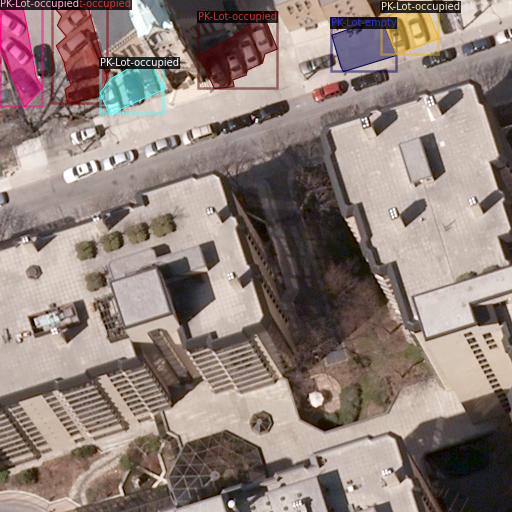

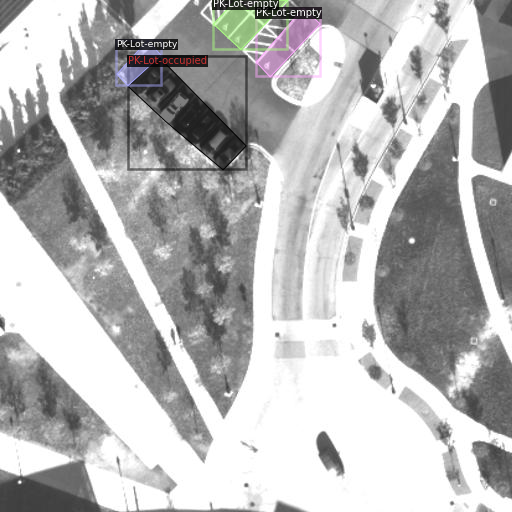

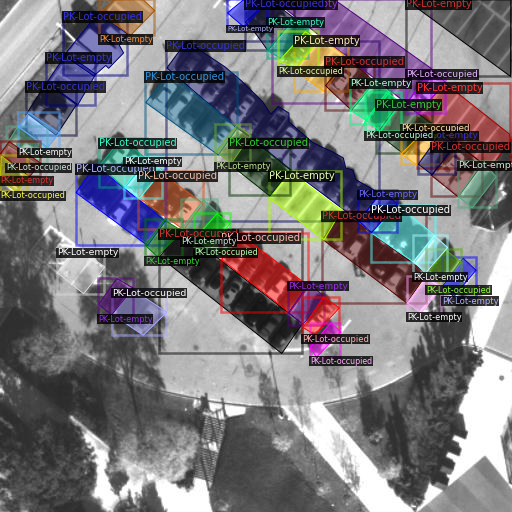

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Train model

Now, let's fine-tune a pretrained FasterRCNN instance segmentation model on the microcontroller data-set.

In [7]:
%%javascript
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}setInterval(ClickConnect,60000)

<IPython.core.display.Javascript object>

In [8]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 700
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[06/25 19:50:42 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (4, 256, 1, 1) 

[06/25 19:50:44 d2.engine.train_loop]: Starting training from iteration 0
[06/25 19:50:48 d2.utils.events]:  eta: 0:01:45  iter: 19  total_loss: 2.622  loss_cls: 1.397  loss_box_reg: 0.161  loss_mask: 0.692  loss_rpn_cls: 0.330  loss_rpn_loc: 0.044  time: 0.1569  data_time: 0.0123  lr: 0.000050  max_mem: 2226M
[06/25 19:50:51 d2.utils.events]:  eta: 0:01:41  iter: 39  total_loss: 1.643  loss_cls: 0.655  loss_box_reg: 0.133  loss_mask: 0.678  loss_rpn_cls: 0.124  loss_rpn_loc: 0.037  time: 0.1552  data_time: 0.0051  lr: 0.000100  max_mem: 2226M
[06/25 19:50:54 d2.utils.events]:  eta: 0:01:39  iter: 59  total_loss: 1.388  loss_cls: 0.358  loss_box_reg: 0.242  loss_mask: 0.655  loss_rpn_cls: 0.126  loss_rpn_loc: 0.037  time: 0.1570  data_time: 0.0059  lr: 0.000150  max_mem: 2341M
[06/25 19:50:57 d2.utils.events]:  eta: 0:01:37  iter: 79  total_loss: 1.477  loss_cls: 0.392  loss_box_reg: 0.293  loss_mask: 0.633  loss_rpn_cls: 0.102  loss_rpn_loc: 0.039  time: 0.1591  data_time: 0.0067  lr:

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Use model for inference

Now, we can perform inference on our validation set by creating a predictor object.

In [10]:
# DatasetCatalog.clear()
# MetadataCatalog.clear()

In [11]:
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
# cfg.DATASETS.TEST = ("my_dataset_test", )
# predictor = DefaultPredictor(cfg)

In [12]:
#test evaluation
test_metadata = MetadataCatalog.get("my_dataset_test")
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/25 19:52:53 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 19:52:53 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json
[06/25 19:52:53 d2.data.build]: Distribution of instances among all 2 categories:
|   category   | #instances   |   category    | #instances   |
|:------------:|:-------------|:-------------:|:-------------|
| PK-Lot-empty | 77           | PK-Lot-occu.. | 62           |
|              |              |               |              |
|    total     | 139          |               |              |
[06/25 19:52:53 d2.data.common]: Serializing 31 elements to byte tensors and concatenating them all ...
[06/25 19:52:53 d2.data.common]: Serialized dataset takes 0.03 MiB
[06/25 19:52:53 d2.evaluation.evaluator]: Start inference on 31 images
[06/25 19:52:53 d2.evaluation.evaluator]: Inference done 11/31. 0.0358 s / 

OrderedDict([('bbox',
              {'AP': 34.12444497212809,
               'AP-PK-Lot-empty': 41.06816969058831,
               'AP-PK-Lot-occupied': 27.18072025366786,
               'AP50': 60.017162026289306,
               'AP75': 33.96189977410274,
               'APl': 66.56215217513993,
               'APm': 35.247343414208515,
               'APs': 29.132106982119392}),
             ('segm',
              {'AP': 32.61926300966308,
               'AP-PK-Lot-empty': 39.72030279533768,
               'AP-PK-Lot-occupied': 25.518223223988475,
               'AP50': 59.98796776802868,
               'AP75': 36.25016249873813,
               'APl': 69.7998222899213,
               'APm': 34.023698671717604,
               'APs': 19.143125660975244})])

WARNING [06/25 19:52:55 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 19:52:55 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json


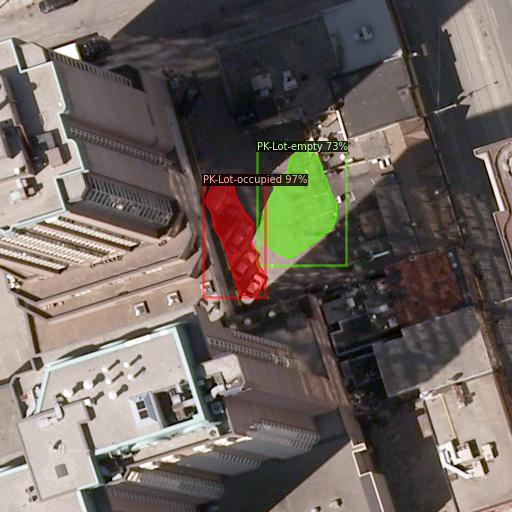

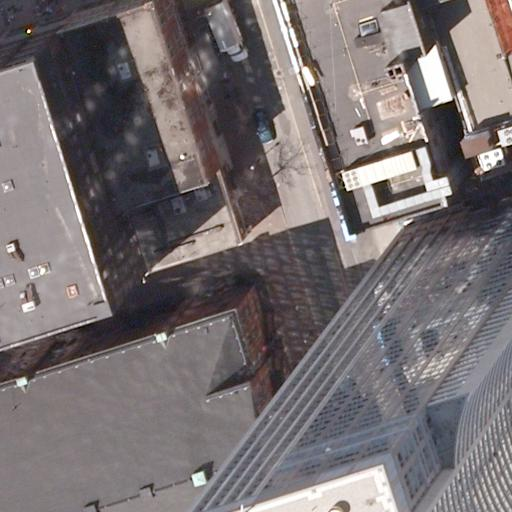

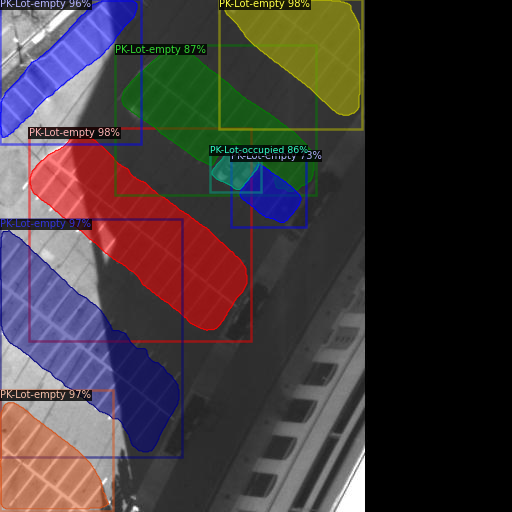

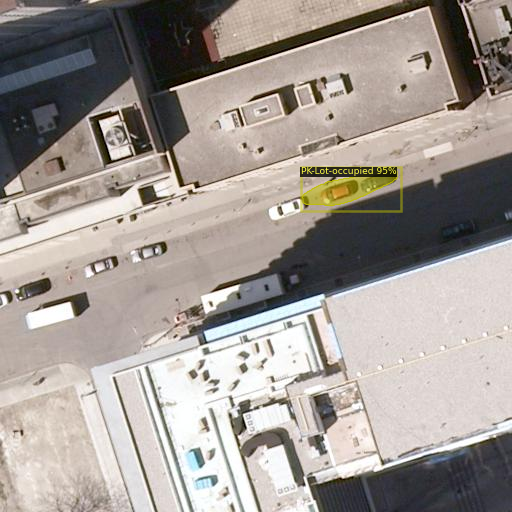

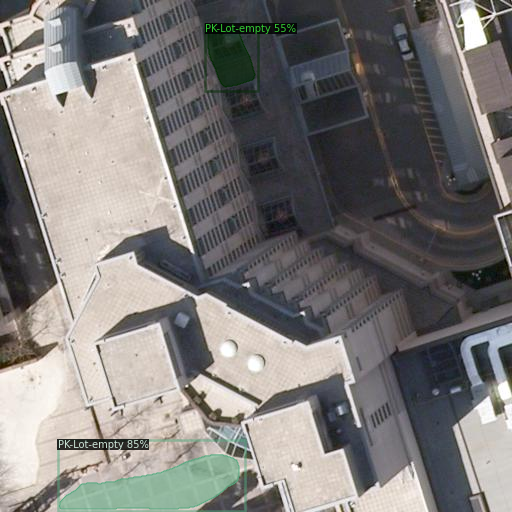

...

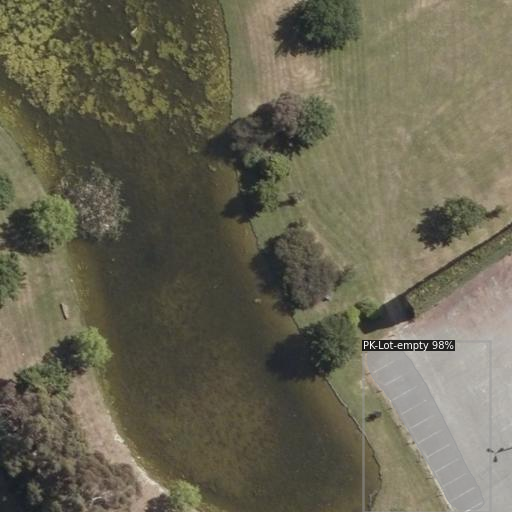

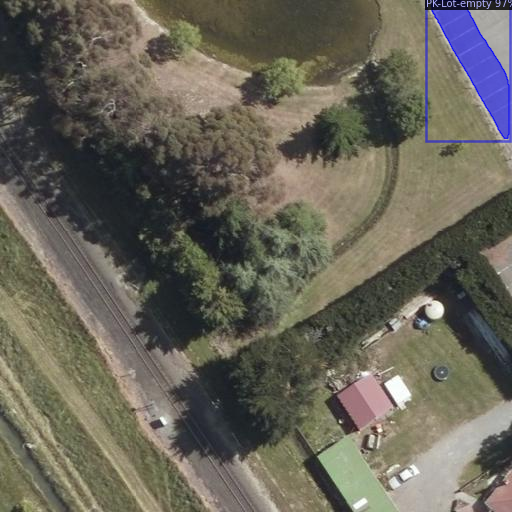

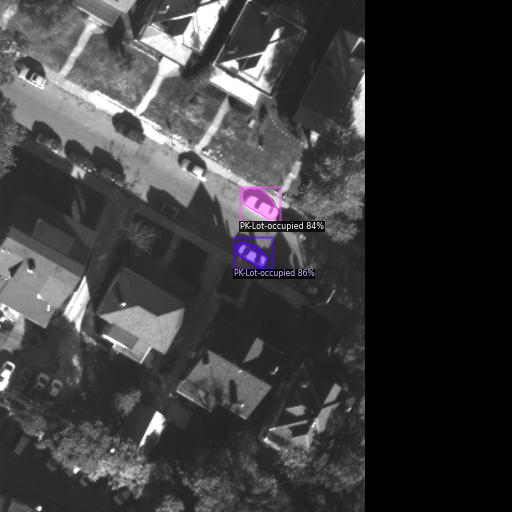

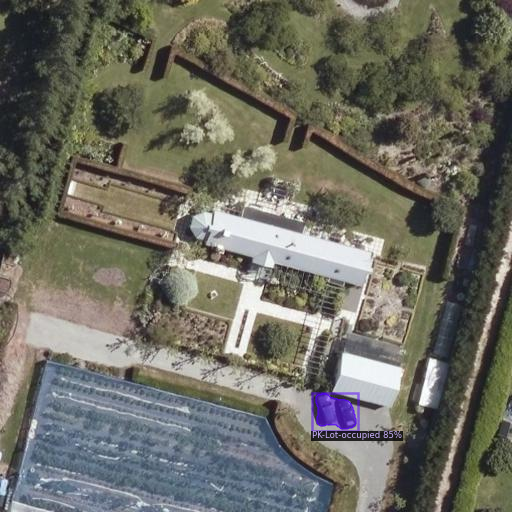

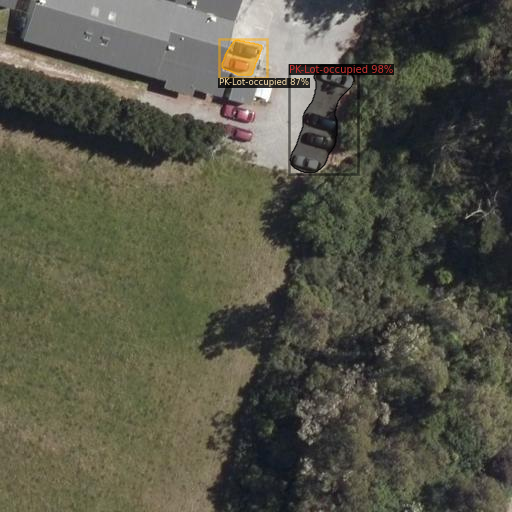

In [13]:

from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("my_dataset_test")
for d in random.sample(dataset_dicts, 20):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=test_metadata, 
                   scale=1, 
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [14]:
# Printing the names of the categories
for i, name in enumerate(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes):
    print(i, name)

0 PK-Lot-empty
1 PK-Lot-occupied


In [62]:
# from detectron2.utils.visualizer import ColorMode
import glob
import json
import numpy as np
from pycocotools import mask
from skimage import measure
import base64

for imageName in glob.glob('/content/drive/MyDrive/Cowc for detectrone2 test/test/*.jpg'):
#for d in dataset_dicts:
  im = cv2.imread(imageName)
  #print(imageName)
  outputs = predictor(im)
  masks = outputs['instances'].pred_masks.cpu().numpy()
  categories = outputs['instances'].pred_classes.cpu().numpy()
  encoded = base64.b64encode(open(imageName, "rb").read())
  number_of_masks = masks.shape[0]
  file_name_1 = imageName.replace("/content/drive/MyDrive/Cowc for detectrone2 test/test/","")
  file_name_2 = file_name_1.replace(".jpg","")
  file_name_3 = file_name_2 + ".json"
  
  main_annotation = {}
  main_annotation['shape'] = []

  # Iterating for all masks. Every mask has one contour and a category relevant for that
  for x in range(0, number_of_masks):
    # Selecting relevant mask. Number of masks == number of categories
    ground_truth_binary_mask = masks[x,:,:]
    category = categories[x]
    if category == 0:
      cat = "PK-Lot-empty"
    else:
      cat = "PK-Lot-occupied"
    #fortran_ground_truth_binary_mask = np.asfortranarray(ground_truth_binary_mask)
    contours = measure.find_contours(ground_truth_binary_mask, 0.5)

    annotation = {
          "shapes" : [],
          "label" : cat,
          "points": None,
          "group_id": None,
          "shape_type": "polygon",
          "flags": {}}
    # for contour in contours:
    # contour = np.flip(contours, axis=1)
    # segmentation = contour.reshape((len(contour.ravel())//2),2).tolist()
    
    print(np.array(contours).shape)
    
    annotation["points"] = contours[0].tolist()
    main_annotation['shape'].append(annotation)

  # print(json.dumps(annotation, indent=4,  separators=(',', ':',)))
  with open(file_name_3, 'w') as file:
    json.dump(annotation, file,indent=4,  separators=(',', ':',))
  break
  break
  #   print(json.dumps(mm, indent=4,  separators=(',', ':',)))

    # file_name_1 = imageName.replace("/content/drive/MyDrive/Cowc for detectrone2 test/test/","")
    # file_name_2 = file_name_1.replace(".jpg","")
    # file_name_3 = file_name_2 + ".json"
    #print(json.dumps(annotation, indent=4,  separators=(',', ':',)))  

    #file.close()  

    # print(mm.type())

  #annotation["imagePath"] = imageName,
    # annotation["imageData"] = encoded,
    # annotation["imageHeight"] = int(512),
    # annotation["imageWidth"] = int(512),
    # print(annotation)
  # f = open("/content/drive/MyDrive/Cowc for detectrone2 test/COWC_PKLot_Predictions.txt","a")
  # f.write(str(d["file_name"]) +"\n" + str(outputs["instances"])+"\n")
  # f.close()

(1, 631, 2)
{
    "shapes":[],
    "label":"PK-Lot-empty",
    "points":[
        [
            [
                506.5,
                78.0
            ],
            [
                506.5,
                77.0
            ],
            [
                506.5,
                76.0
            ],
            [
                506.5,
                75.0
            ],
            [
                506.5,
                74.0
            ],
            [
                506.5,
                73.0
            ],
            [
                506.5,
                72.0
            ],
            [
                506.5,
                71.0
            ],
            [
                506.5,
                70.0
            ],
            [
                506.5,
                69.0
            ],
            [
                506.5,
                68.0
            ],
            [
                506.5,
                67.0
            ],
            [
                506.5,
   

In [17]:
number_of_masks = masks.shape[0]
for x in range(0, number_of_masks):
  #print(x)
  ground_truth_binary_mask = masks[x,:,:]
  #print(ground_truth_binary_mask)
  category = categories[x]
  if category == 0:
    cat = "PK-Lot-empty"
  else:
    cat == "PK-Lot-occupied"
  fortran_ground_truth_binary_mask = np.asfortranarray(ground_truth_binary_mask)
  # encoded_ground_truth = mask.encode(fortran_ground_truth_binary_mask)
  # ground_truth_area = mask.area(encoded_ground_truth)
  # ground_truth_bounding_box = mask.toBbox(encoded_ground_truth)
  contours = measure.find_contours(ground_truth_binary_mask, 0.5)

  annotation = {
        "shapes" : [],
        "label" : cat,
        "points": [],
        "group_id": None,
        "shape_type": "polygon",
        "flags": {}}
  # file_info : {
  #     "imagePath": imageName,
  #     "imageData" : encoded,
  #     "imageHeight": 512,
  #   "imageWidth": 512
  #   }
  for contour in contours:
    contour = np.flip(contour, axis=1)
    #segmentation = contour.ravel().tolist()
    segmentation = contour.reshape((len(contour.ravel())//2),2).tolist()
    annotation["points"].append(segmentation)
  print(json.dumps(annotation, indent=4,  separators=(',', ':',)))
# annotation["imagePath"] = imageName,
# annotation["imageData"] = encoded,
# annotation["imageHeight"] = 512,
# annotation["imageWidth"] = 512,
# print(annotation)

{
    "shapes":[],
    "label":"PK-Lot-empty",
    "points":[
        [
            [
                78.0,
                506.5
            ],
            [
                77.0,
                506.5
            ],
            [
                76.0,
                506.5
            ],
            [
                75.0,
                506.5
            ],
            [
                74.0,
                506.5
            ],
            [
                73.0,
                506.5
            ],
            [
                72.0,
                506.5
            ],
            [
                71.0,
                506.5
            ],
            [
                70.0,
                506.5
            ],
            [
                69.0,
                506.5
            ],
            [
                68.0,
                506.5
            ],
            [
                67.0,
                506.5
            ],
            [
                66.0,
                

In [18]:
# type(outputs)

In [19]:
# try:
#     import cPickle as pickle
# except ImportError:  # Python 3.x
#     import pickle

# with open('data_pp.p', 'wb') as fp:
#     pickle.dump(outputs, fp, protocol=pickle.HIGHEST_PROTOCOL)


In [20]:
# with open('data_pp.p', 'rb') as fp:
#     data_pp = pickle.load(fp)

In [21]:
# type(data_pp['instances'])

In [22]:
# data_pp